In [1]:
import numpy as np
%pylab inline
import matplotlib.pyplot as plt
from scipy import signal
import os
import io
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten
from keras import models
from keras.utils.np_utils import to_categorical
import skimage.draw
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from keras.applications import vgg16
from keras.applications.vgg16 import preprocess_input
from os import listdir
from PIL import Image
from numpy import asarray
from matplotlib import pyplot
from mtcnn.mtcnn import MTCNN
from os.path import isdir
from numpy import savez_compressed
from numpy import asarray

Populating the interactive namespace from numpy and matplotlib


In [2]:
import keras
keras.__version__

'2.4.3'

In [3]:
# extract a single face from a given photograph
def extract_face(filename, required_size=(160, 160)):
  # load image from file
  image = Image.open(filename)
  # convert to RGB, if needed
  image = image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the first face
  try:
    x1, y1, width, height = results[0]['box']
    # bug fix
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + width, y1 + height
    # extract the face
    face = pixels[y1:y2, x1:x2]
    # resize pixels to the model size
    image = Image.fromarray(face)
    image = image.resize(required_size)
    face_array = asarray(image)
    return face_array
  except IndexError:
    face_array=[]
    print("Out of index")


1 (160, 160, 3)
2 (160, 160, 3)
3 (160, 160, 3)


4 (160, 160, 3)
5 (160, 160, 3)


6 (160, 160, 3)
7 (160, 160, 3)


8 (160, 160, 3)
9 (160, 160, 3)


ValueError: num must be 1 <= num <= 8, not 9

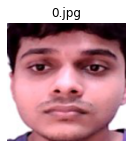

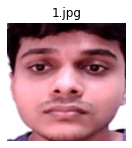

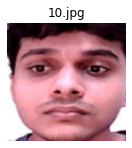

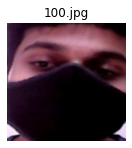

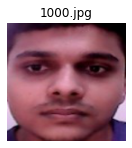

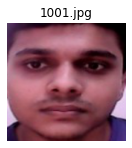

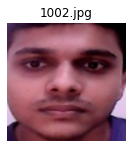

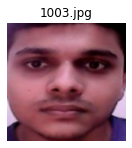

<Figure size 864x720 with 0 Axes>

In [4]:
# specify folder to plot
i = 1
folder = 'C:/Users/ASUS/testproject/Dataset/Nikhil/'
# enumerate files
for filename in listdir(folder):
  # path
  path = folder + filename
  # get face
  face = extract_face(path)
  from matplotlib.pyplot import figure
  figure(num=None, figsize=(12, 10))
  if face is not None:
    print(i, face.shape)
    # plot
    pyplot.subplot(4, 2, i)
    pyplot.title(filename)
    pyplot.axis('off')
    pyplot.imshow(face)
    i += 1
pyplot.show()

In [5]:
from os import listdir
from os.path import isdir
from PIL import Image
from matplotlib import pyplot
from numpy import savez_compressed
from numpy import asarray
from mtcnn.mtcnn import MTCNN


# extract a single face from a given photograph
def extract_face(filename, required_size=(224, 224)):
  # load image from file
  image = Image.open(filename)
  # convert to RGB, if needed
  image = image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the first face
  try:
    x1, y1, width, height = results[0]['box']
    # bug fix
    x1, y1 = abs(x1), abs(y1)
    x2, y2 = x1 + width, y1 + height
    # extract the face
    face = pixels[y1:y2, x1:x2]
    # resize pixels to the model size
    image = Image.fromarray(face)
    image = image.resize(required_size)
    face_array = asarray(image)
    return face_array
  except IndexError:
    face_array=[]
    print("Out of index")
  
 
# load images and extract faces for all images in a directory
def load_faces(directory):
  faces = list()
  # enumerate files
  for filename in listdir(directory):
    # path
    path = directory + filename
    # get face
    face = extract_face(path)
    if face is not None:
      # store
      faces.append(face)
  return faces
 
# load a dataset that contains one subdir for each class that in turn contains images
def load_dataset(directory):
	X, y = list(), list()
	# enumerate folders, on per class
	for subdir in listdir(directory):
		# path
		path = directory + subdir + '/'
		# skip any files that might be in the dir
		if not isdir(path):
			continue
		# load all faces in the subdirectory
		faces = load_faces(path)
		# create labels
		labels = [subdir for _ in range(len(faces))]
		# summarize progress
		print('>loaded %d examples for class: %s' % (len(faces), subdir))
		# store
		X.extend(faces)
		y.extend(labels)
	return asarray(X), asarray(y)

In [6]:
# extract all faces from a given photograph
def extract_all_faces(filename, required_size=(224, 224)):
  # load image from file
  original_image = Image.open(filename)
  # convert to RGB, if needed
  image = original_image.convert('RGB')
  # convert to array
  pixels = asarray(image)
  # create the detector, using default weights
  detector = MTCNN()
  # detect faces in the image
  results = detector.detect_faces(pixels)
  # extract the bounding box from the faces
  face_array=[]
  try:
    for result in results:
      x1, y1, width, height = result['box']
      x1, y1 = abs(x1), abs(y1)
      x2, y2 = x1 + width, y1 + height
      # extract the face
      face = pixels[y1:y2, x1:x2]
      #print()
      #print(original_image)
      #print(face.shape[0])
      #print("original_image.size[0]/20")
      #print(original_image.size[0]/20)
      if face.shape[0] >= original_image.size[0]/20:
        print(face.shape)
        # resize pixels to the model size
        image = Image.fromarray(face)
        image = image.resize(required_size)
        face_array.append(asarray(image))

    return face_array
  except IndexError:
    print("Out of index")

In [8]:
trainX, trainy = load_dataset('C:/Users/ASUS/testproject/dataset/')
print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
savez_compressed('nikhilnair_photos.npz', trainX, trainy)

>loaded 1035 examples for class: Nikhil
(1035, 224, 224, 3) (1035,)


In [9]:
trainy[0]

'Nikhil'

In [76]:
x_train_cam, y_train_cam = load_dataset('C:/Users/ASUS/testproject/wholedataset/')
print(trainX.shape, trainy.shape)
# load test dataset
# save arrays to one file in compressed format
savez_compressed('whole_photos.npz', x_train_cam, y_train_cam)


>loaded 1035 examples for class: Nikhil


>loaded 1027 examples for class: Nithya
(1035, 224, 224, 3) (1035,)


In [12]:
# load the faces dataset
data = load('nikhilnair_photos.npz')     
x_train_nikhil, y_train_nikhil = data['arr_0'], data['arr_1']
print('Loaded: ', x_train_nikhil.shape, y_train_nikhil.shape)

Loaded:  (1035, 224, 224, 3) (1035,)


In [13]:
np.unique(y_train_cam, return_counts=True)

NameError: name 'y_train_cam' is not defined

In [14]:
x_train = np.concatenate((x_train_cam, x_train_nikhil), axis=0)
x_train.shape

NameError: name 'x_train_cam' is not defined

In [15]:
y_train = np.concatenate((y_train_cam, y_train_nikhil), axis=0)
y_train.shape

NameError: name 'y_train_cam' is not defined

In [16]:
np.unique(y_train, return_counts=True)

NameError: name 'y_train' is not defined

In [74]:
x_gopal_photos, y_gopal_photos = load_dataset('C:/Users/ASUS/testproject/nithyadataset/')
print(x_gopal_photos.shape, y_gopal_photos.shape)
savez_compressed('nithya_photos.npz', x_gopal_photos, y_gopal_photos)

>loaded 1027 examples for class: Nithya
(1027, 224, 224, 3) (1027,)


NameError: name 'x_gopal_photos' is not defined

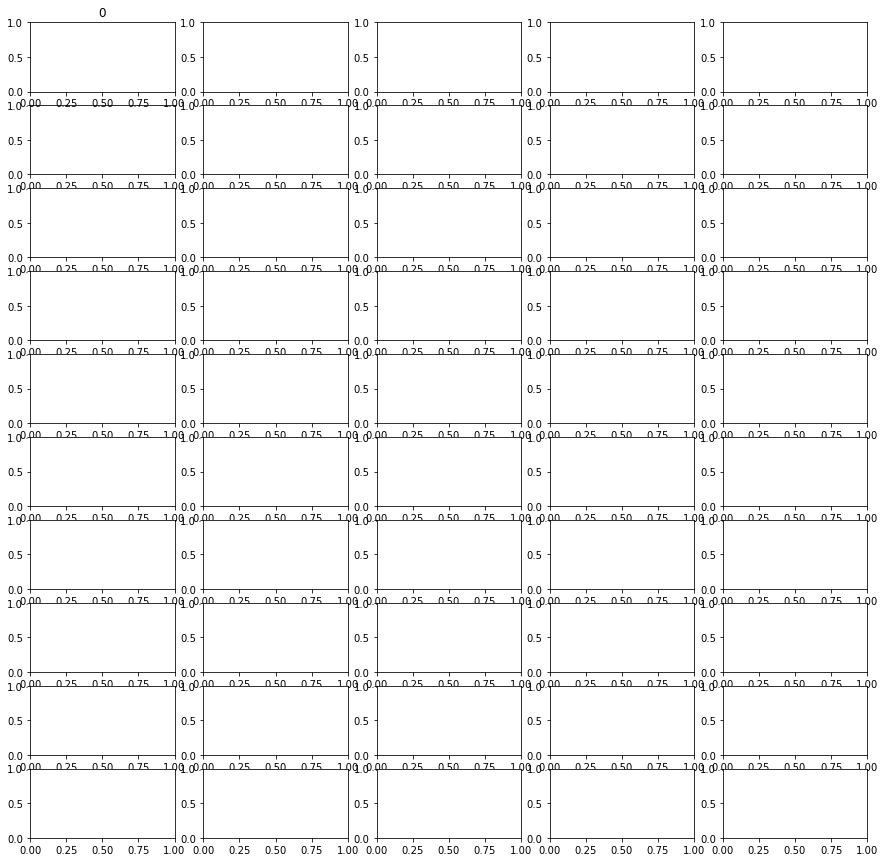

In [17]:
plt.subplots(10,5,figsize=(15,15))
for i in range(49):
    plt.subplot(10,5,i+1)
    plt.title(i*1)
    plt.imshow(x_gopal_photos[i*1])
    plt.xticks([])
    plt.yticks([])

In [18]:
y_gopal_photos.shape

NameError: name 'y_gopal_photos' is not defined

In [19]:
x_d = x_train[np.where(y_train == 'Nithya')]
print(x_d.shape)

y_d = y_train[np.where(y_train == 'Nithya')]
print(y_d.shape)

NameError: name 'x_train' is not defined

In [20]:
n = 200  # for 2 random indices
index = np.random.choice(x_gopal_photos.shape[0], n, replace=False)  

x_gopal_sample = x_gopal_photos[index]
y_gopal_sample = y_gopal_photos[index]

NameError: name 'x_gopal_photos' is not defined

In [21]:
x_gopal_all = np.concatenate((x_gopal_sample,x_gopal_photos), axis=0)
y_gopal_all = np.concatenate((y_gopal_sample,y_gopal_photos), axis=0)

NameError: name 'x_gopal_sample' is not defined

In [199]:
x_gopal_all.shape

(1227, 224, 224, 3)

In [200]:
x_r = x_train[np.where(y_train == 'Nikhil')]
print(x_r.shape)

y_r = y_train[np.where(y_train == 'Nikhil')]
print(y_r.shape)

(2070, 224, 224, 3)
(2070,)


In [201]:
X = np.concatenate((x_gopal_all,x_r),axis=0)
Y = np.concatenate((y_gopal_all,y_r),axis=0)

In [202]:
X.shape

(3297, 224, 224, 3)

In [203]:
Y.shape

(3297,)

In [204]:
np.unique(Y, return_counts=True)

(array(['Nikhil', 'Nithya'], dtype='<U6'), array([2070, 1227], dtype=int64))

In [205]:
# The latest full dataset
savez_compressed('complete_dataset_nikhil_and_nithya.npz', X, Y)

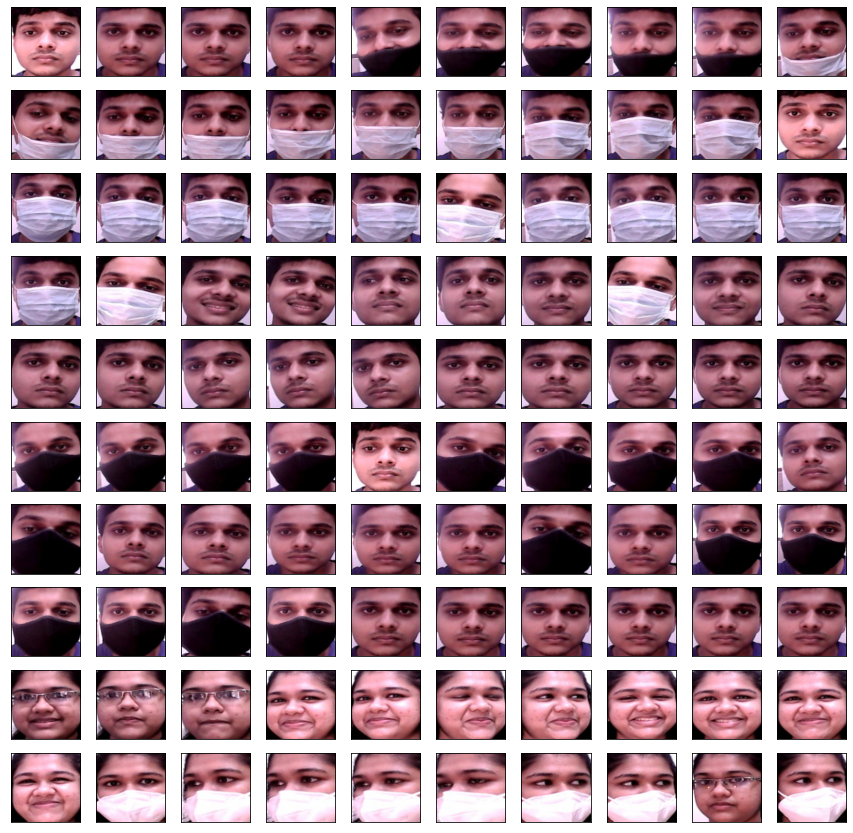

In [275]:
plt.subplots(10,10,figsize=(15,15))
for i in range(100):
    plt.subplot(10,10,i+1)
    plt.imshow(X[i*13])
    plt.xticks([])
    plt.yticks([])

In [22]:
# load the faces dataset
data = load('whole_photos.npz')     
X, Y = data['arr_0'], data['arr_1']
print('Loaded: ', X.shape, Y.shape)

Loaded:  (2062, 224, 224, 3) (2062,)


In [23]:
img = X[100]

In [24]:
import cv2
import random
import numpy as np

def brightness(img, low, high):
    value = random.uniform(low, high)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    hsv = np.array(hsv, dtype = np.float64)
    hsv[:,:,1] = hsv[:,:,1]*value
    hsv[:,:,1][hsv[:,:,1]>255]  = 255
    hsv[:,:,2] = hsv[:,:,2]*value 
    hsv[:,:,2][hsv[:,:,2]>255]  = 255
    hsv = np.array(hsv, dtype = np.uint8)
    img = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return img

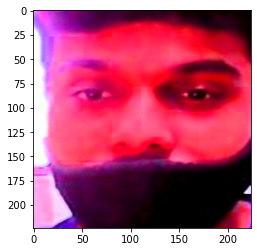

In [25]:
img_result = brightness(img, 0.1, 2)
plt.imshow(img_result)

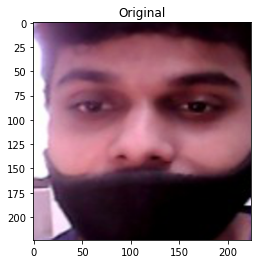

In [26]:
plt.title("Original")
plt.imshow(img)

In [27]:
import cv2
import random

def augment_data(imgs, scales, rotations, brightness_values, shifts, labels):
  timg=[]
  y_hat=[]
  for (img,label) in zip(imgs,labels):
    rows, cols, ch = img.shape 
    for j in rotations:
      f = random.uniform(0, 1)
      #f = random.choice([0,1])
      rot_mat = cv2.getRotationMatrix2D( (14,14), j, 1);
      affined_img = cv2.warpAffine( img, rot_mat, (cols, rows), borderValue=(1,1,1))
      resulting_img = affined_img
      if f == 1:
        resulting_img = cv2.flip(resulting_img, f)
      resulting_img = brightness(resulting_img, brightness_values[0], brightness_values[1])
      timg.append(resulting_img)
      y_hat.append(label)
  return np.array(timg), np.array(y_hat)

In [28]:
scales = np.arange(0.9, 1, 0.1)
rotations = np.arange(0, 2)
brightness_values = [ 0.4, 2]
shifts = [ 0.2]
au_x, au_y = augment_data(X, scales, rotations, brightness_values, shifts, Y)

In [29]:
au_x.shape

(4124, 224, 224, 3)

In [30]:
np.unique(au_y, return_counts=True)

(array(['Nikhil', 'Nithya'], dtype='<U6'), array([2070, 2054], dtype=int64))

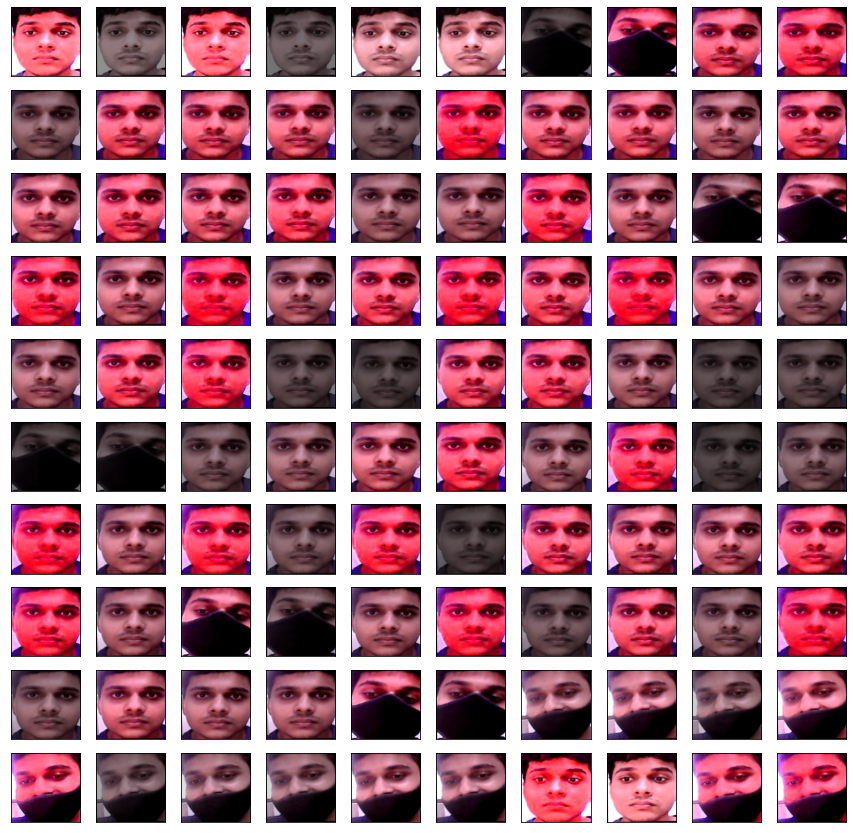

In [31]:
plt.subplots(10,10,figsize=(15,15))
for i in range(100):
    plt.subplot(10,10,i+1)
    plt.imshow(au_x[i])
    plt.xticks([])
    plt.yticks([])

In [32]:
from sklearn.model_selection import train_test_split
# split into train test sets
au_x_train, au_x_test, au_y_train, au_y_test = train_test_split(au_x, au_y, test_size=0.33)
print(au_x_train.shape, au_x_test.shape, au_y_train.shape, au_y_test.shape)

(2763, 224, 224, 3) (1361, 224, 224, 3) (2763,) (1361,)


In [33]:
from sklearn.preprocessing import LabelEncoder
# label encode targets
out_encoder = LabelEncoder()
out_encoder.fit(au_y_train)
au_y_train = out_encoder.transform(au_y_train)
au_y_test = out_encoder.transform(au_y_test)

In [34]:
au_y_train.shape

(2763,)

In [35]:
au_y_test.shape

(1361,)

In [36]:
from tensorflow.keras.utils import to_categorical
au_train_labels = to_categorical(au_y_train)
au_test_labels = to_categorical(au_y_test)

print(au_train_labels.shape)
print(au_test_labels.shape)

(2763, 2)
(1361, 2)


In [37]:
savez_compressed('data_one_hot_encoded.npz', au_x_train, au_train_labels, au_x_test, au_test_labels)

In [38]:
# load the faces dataset
data = load('data_one_hot_encoded.npz')     
au_x_train, au_train_labels, au_x_test, au_test_labels= data['arr_0'], data['arr_1'],data['arr_2'], data['arr_3']
print('Loaded: ', au_x_train.shape, au_train_labels.shape,  au_x_test.shape, au_test_labels.shape)

Loaded:  (2763, 224, 224, 3) (2763, 2) (1361, 224, 224, 3) (1361, 2)


In [39]:
from keras.layers import BatchNormalization, GlobalMaxPooling2D

model1 = Sequential()

# Convolution layers
model1.add(Conv2D(32, (3,3), input_shape = (224, 224, 3), activation = 'relu', padding='same'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
model1.add(MaxPooling2D(2))

model1.add(Conv2D(64, (2, 2), activation='relu', padding='same'))
model1.add(MaxPooling2D(pool_size=(2, 2)))

model1.add(Flatten())
model1.add(Dense(units = 64, activation = 'relu'))
model1.add(Dropout(0.2)) 

# Output
model1.add(Dense(units = 2, activation = 'softmax'))
model1.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12528 (Conv2D)        (None, 224, 224, 32)      896       
_________________________________________________________________
max_pooling2d_6264 (MaxPooli (None, 112, 112, 32)      0         
_________________________________________________________________
conv2d_12529 (Conv2D)        (None, 112, 112, 64)      8256      
_________________________________________________________________
max_pooling2d_6265 (MaxPooli (None, 56, 56, 64)        0         
_________________________________________________________________
conv2d_12530 (Conv2D)        (None, 56, 56, 64)        16448     
_________________________________________________________________
max_pooling2d_6266 (MaxPooli (None, 28, 28, 64)        0         
_________________________________________________________________
flatten_2088 (Flatten)       (None, 50176)             0

In [40]:
# Compiling the CNN
model1.compile(optimizer = 'adam',
                   loss='categorical_crossentropy',
                   metrics = ['accuracy'])

In [41]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

#early_stop = EarlyStopping(monitor='val_loss', patience = 3)
early_stop = EarlyStopping(monitor='val_loss', patience = 3)
checkpoint = ModelCheckpoint('facial_recognition_nithya_nair_scratch.h5', monitor = 'val_acc')

In [43]:
pre_au_x_train = preprocess_input(au_x_train)
pre_au_x_test = preprocess_input(au_x_test)

In [44]:
history = model1.fit(pre_au_x_train, au_train_labels, 
                     batch_size = 128, epochs=20, 
                     validation_data = (pre_au_x_test, au_test_labels), 
                     callbacks = [early_stop, checkpoint])

Epoch 1/20
22/22 [==============================] - 78s 4s/step - loss: 86.9781 - accuracy: 0.5453 - val_loss: 0.2114 - val_accuracy: 0.9677
Epoch 2/20
22/22 [==============================] - 79s 4s/step - loss: 0.1728 - accuracy: 0.9372 - val_loss: 0.0066 - val_accuracy: 0.9978
Epoch 3/20
22/22 [==============================] - 74s 3s/step - loss: 0.0325 - accuracy: 0.9950 - val_loss: 0.0022 - val_accuracy: 0.9993
Epoch 4/20
22/22 [==============================] - 86s 4s/step - loss: 0.0198 - accuracy: 0.9943 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 5/20
22/22 [==============================] - 60s 3s/step - loss: 0.0199 - accuracy: 0.9966 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 6/20
22/22 [==============================] - 59s 3s/step - loss: 0.0188 - accuracy: 0.9986 - val_loss: 3.3612e-04 - val_accuracy: 1.0000
Epoch 7/20
22/22 [==============================] - 58s 3s/step - loss: 0.0163 - accuracy: 0.9991 - val_loss: 1.5571e-04 - val_accuracy: 1.0000
Epoch 8/20


In [45]:
preds1 = model1.predict(pre_au_x_test, batch_size=50) # y_test are the truth, real labels correct ones.
# classes are the model predictions (That can be wrong or match the real ones)
print("Total predicted classes are:",len(preds1))

Total predicted classes are: 1361


In [48]:
from sklearn.metrics import accuracy_score
accuracy_score(au_test_labels.argmax(axis=1), preds1.argmax(axis=1))

1.0

In [49]:
from keras.utils.vis_utils import plot_model
plot_model(model1, to_file='model_plot1.png', show_shapes=True, show_layer_names=True)

('Failed to import pydot. You must `pip install pydot` and install graphviz (https://graphviz.gitlab.io/download/), ', 'for `pydotprint` to work.')


In [50]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred1 = np.argmax(preds1, axis=1)
print('Confusion Matrix')
print(confusion_matrix(au_test_labels.argmax(axis=1), y_pred1))
print('Classification Report')
target_names = ['Nikhil', 'Nithya']
print(classification_report(au_test_labels.argmax(axis=1), y_pred1, target_names=target_names))

Confusion Matrix
[[696   0]
 [  0 665]]
Classification Report
              precision    recall  f1-score   support

      Nikhil       1.00      1.00      1.00       696
      Nithya       1.00      1.00      1.00       665

    accuracy                           1.00      1361
   macro avg       1.00      1.00      1.00      1361
weighted avg       1.00      1.00      1.00      1361



In [51]:
# load and evaluate a saved model
from numpy import loadtxt
from keras.models import load_model

# load model
model1 = load_model('facial_recognition_nithya_nair_scratch.h5')

In [67]:
def test_model1_on_photo_from_path(file_path,verbose=False):
  recognized_person = {0:'Nikhil',1:'Nithya'}
  plt.figure(figsize=(10, 8))
  image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(image)
  plt.show()
  image = extract_face(file_path)
  preprocessed_image = preprocess_input(image)
  shaped_img = preprocessed_image.reshape(1,224,224,3)
  classes = model1.predict(shaped_img) # y_test are the truth, real labels correct ones.
  # classes are the model predictions (That can be wrong or match the real ones)
  print("Total predicted classes are:",len(classes))
  print(int(classes.argmax(axis=1)))
  plt.title(recognized_person[int(classes.argmax(axis=1))])
  plt.imshow(image)
  plt.show()
  if verbose:
    print(classes)

### Nikhil image with mask

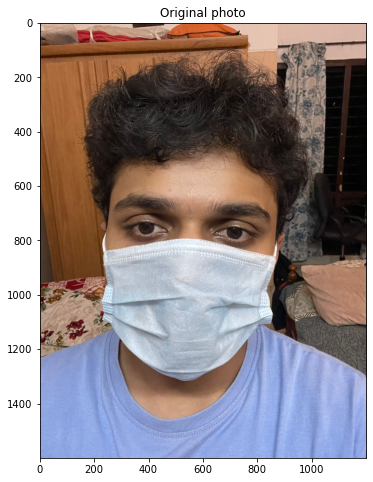

Total predicted classes are: 1
0


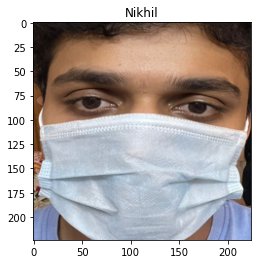

In [73]:
test_model1_on_photo_from_path("f11.jpeg")

### Nikhil Image Without Mask

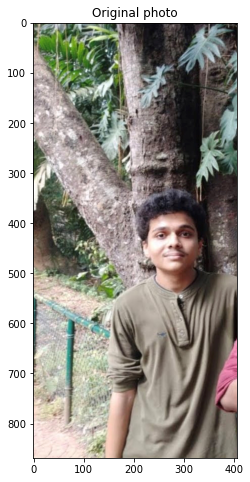

Total predicted classes are: 1
0


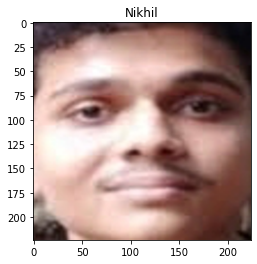

In [115]:
test_model1_on_photo_from_path("f3.jpg")

### Nithya Image with mask

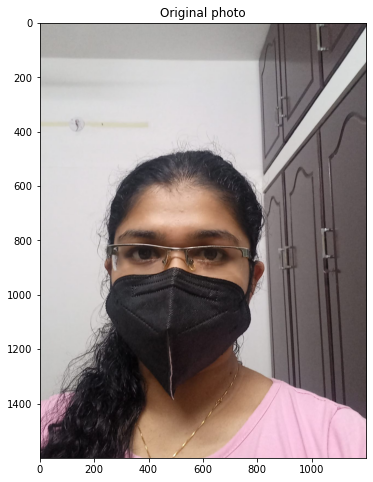

Total predicted classes are: 1
1


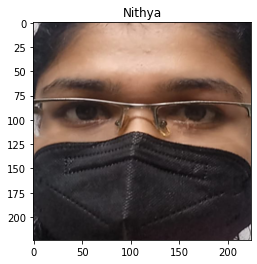

In [78]:
test_model1_on_photo_from_path("f13.jpeg")

### Nithya image Without mask

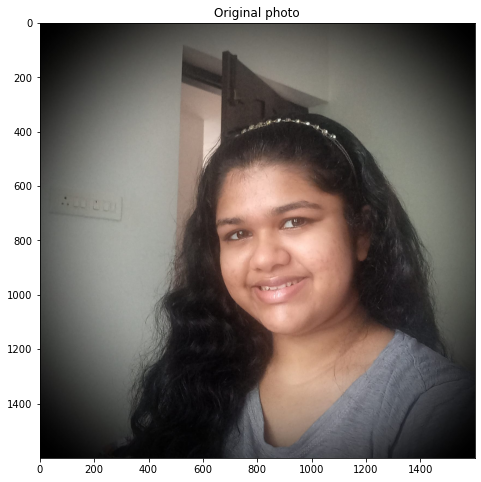

Total predicted classes are: 1
1


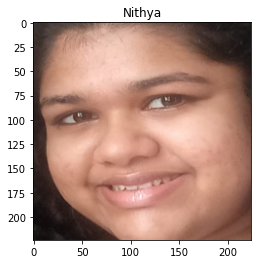

In [83]:
test_model1_on_photo_from_path("f7.jpeg")

In [79]:
def test_model_on_photo_all_faces_from_path(file_path,verbose=False):
  recognized_person = {0:'Nikhil',1:'Nithya'}
  plt.figure(figsize=(10, 8))
  original_image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(original_image)
  plt.show()
  images = extract_all_faces(file_path)
  for image in images:
    preprocessed_image = preprocess_input(image)
    shaped_img = preprocessed_image.reshape(1,224,224,3)
    classes = model1.predict(shaped_img) # y_test are the truth, real labels correct ones.
    # classes are the model predictions (That can be wrong or match the real ones)
    print("Total predicted classes are:",len(classes))
    print(int(classes.argmax(axis=1)))
    plt.title(recognized_person[int(classes.argmax(axis=1))])
    plt.imshow(image)
    plt.show()
    if verbose:
      print(classes)

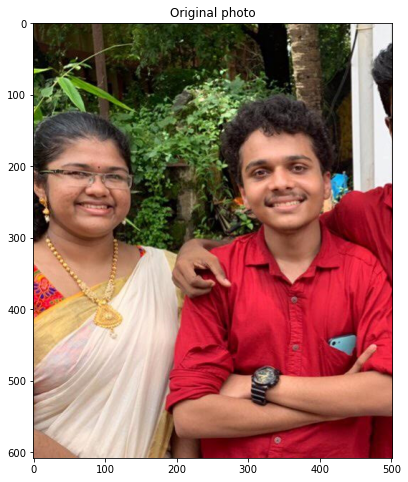

(135, 114, 3)
(135, 109, 3)
Total predicted classes are: 1
1


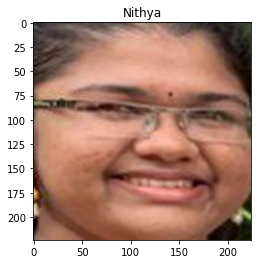

[[0.00203893 0.99796104]]
Total predicted classes are: 1
1


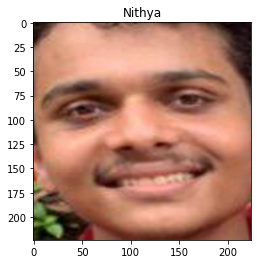

[[0.0120388  0.98796123]]


In [86]:
test_model_on_photo_all_faces_from_path("f14.jpg", True)

##  Transfer Learning MODEL !!!!

name 'take_photo' is not defined


In [87]:
from keras.layers import BatchNormalization

model_vgg16 = vgg16.VGG16(include_top=False, pooling="max", input_shape = (224, 224, 3)) 

new_layer = Dense(256, activation = 'relu')(model_vgg16.output)
new_layer = Dropout(rate = 0.5)(new_layer)

new_layer = Dense(128, activation = 'relu')(new_layer)
new_layer = Dropout(rate = 0.5)(new_layer)
new_layer = BatchNormalization()(new_layer)
new_layer = Dense(2, activation="softmax")(new_layer)

model2 = models.Model(model_vgg16.input, new_layer)

for i in range(len(model_vgg16.layers)):
  model2.layers[i].trainable = False

print(model2.summary())

Model: "model_3210"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3211 (InputLayer)      [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0

In [88]:
# Compiling the CNN
model2.compile(optimizer = 'adam',
                   loss='categorical_crossentropy',
                   metrics = ['accuracy'])

In [89]:
from keras.applications.vgg16 import preprocess_input
pre_au_x_train = preprocess_input(au_x_train)
pre_au_x_test = preprocess_input(au_x_test)

In [90]:
from keras.callbacks import EarlyStopping, ModelCheckpoint

early_stop = EarlyStopping(monitor='val_loss', patience = 3)
checkpoint = ModelCheckpoint('facial_recongition_daniela_rebeca.h5', monitor = 'val_accuracy', save_best_only=True)

In [91]:
history = model2.fit(pre_au_x_train, au_train_labels, 
                     batch_size = 64, epochs=18, 
                     validation_data = (pre_au_x_test, au_test_labels), 
                     callbacks = [early_stop, checkpoint])

Epoch 1/18
44/44 [==============================] - 412s 9s/step - loss: 0.5591 - accuracy: 0.7498 - val_loss: 0.0147 - val_accuracy: 0.9934
Epoch 2/18
44/44 [==============================] - 581s 13s/step - loss: 0.0339 - accuracy: 0.9956 - val_loss: 0.0028 - val_accuracy: 1.0000
Epoch 3/18
44/44 [==============================] - 699s 16s/step - loss: 0.0173 - accuracy: 0.9971 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 4/18
44/44 [==============================] - 453s 10s/step - loss: 0.0103 - accuracy: 0.9990 - val_loss: 0.0013 - val_accuracy: 1.0000
Epoch 5/18
44/44 [==============================] - 460s 11s/step - loss: 0.0054 - accuracy: 1.0000 - val_loss: 7.9500e-04 - val_accuracy: 1.0000
Epoch 6/18
44/44 [==============================] - 465s 11s/step - loss: 0.0060 - accuracy: 0.9991 - val_loss: 7.8525e-04 - val_accuracy: 1.0000
Epoch 7/18
44/44 [==============================] - 660s 15s/step - loss: 0.0037 - accuracy: 1.0000 - val_loss: 3.9801e-04 - val_accuracy: 1.

In [92]:
preds = model2.predict(pre_au_x_test, batch_size=50) # y_test are the truth, real labels correct ones.
# classes are the model predictions (That can be wrong or match the real ones)
print("Total predicted classes are:",len(preds))

Total predicted classes are: 1361


In [93]:
from sklearn.metrics import accuracy_score
accuracy_score(au_test_labels.argmax(axis=1), preds.argmax(axis=1))

1.0

In [94]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred = np.argmax(preds, axis=1)
print('Confusion Matrix')
print(confusion_matrix(au_y_test, y_pred))
print('Classification Report')
target_names = ['Nikhil', 'Nithya']
print(classification_report(au_y_test, y_pred, target_names=target_names))

Confusion Matrix
[[696   0]
 [  0 665]]
Classification Report
              precision    recall  f1-score   support

      Nikhil       1.00      1.00      1.00       696
      Nithya       1.00      1.00      1.00       665

    accuracy                           1.00      1361
   macro avg       1.00      1.00      1.00      1361
weighted avg       1.00      1.00      1.00      1361



In [98]:
from keras.models import load_model
best_model = load_model('facial_recongition_daniela_rebeca.h5')

In [102]:
recognized_person = {0:'Nikhil',1:'Nithya'}
def test_model_on_photo_from_path(file_path,verbose=False):
  recognized_person = {0:'Nikhil',1:'Nithya'}
  plt.figure(figsize=(10, 8))
  image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(image)
  plt.show()
  image = extract_face(file_path)
  preprocessed_image = preprocess_input(image)
  shaped_img = preprocessed_image.reshape(1,224,224,3)
  classes = model2.predict(shaped_img) # y_test are the truth, real labels correct ones.
  # classes are the model predictions (That can be wrong or match the real ones)
  print("Total predicted classes are:",len(classes))
  print(int(classes.argmax(axis=1)))
  plt.title(recognized_person[int(classes.argmax(axis=1))])
  plt.imshow(image)
  plt.show()
  if verbose:
    print(classes)

def test_model_on_photo_all_faces_from_path(file_path,verbose=False):
  recognized_person = {0:'Nikhil',1:'Nithya'}
  plt.figure(figsize=(10, 8))
  original_image = Image.open(file_path)
  plt.title("Original photo")
  plt.imshow(original_image)
  plt.show()
  images = extract_all_faces(file_path)
  for image in images:
    preprocessed_image = preprocess_input(image)
    shaped_img = preprocessed_image.reshape(1,224,224,3)
    classes = model2.predict(shaped_img) # y_test are the truth, real labels correct ones.
    # classes are the model predictions (That can be wrong or match the real ones)
    print("Total predicted classes are:",len(classes))
    print(int(classes.argmax(axis=1)))
    plt.title(recognized_person[int(classes.argmax(axis=1))])
    plt.imshow(image)
    plt.show()
    if verbose:
      print(classes)

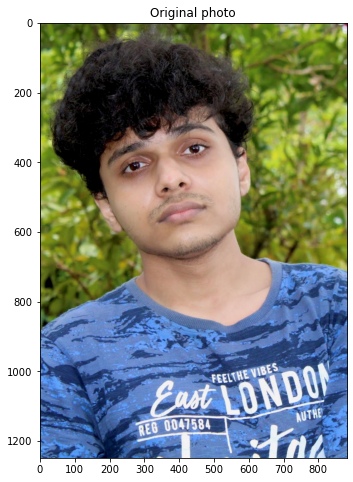

Total predicted classes are: 1
0


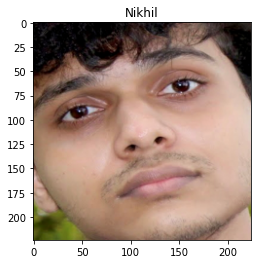

In [113]:
test_model_on_photo_from_path("f2.jpg")

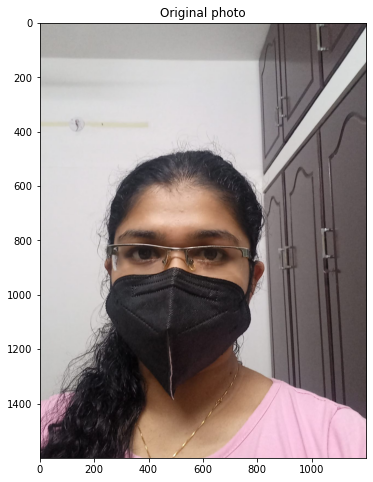

(564, 482, 3)
Total predicted classes are: 1
1


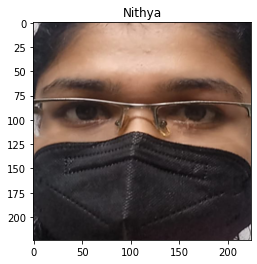

In [121]:
test_model_on_photo_all_faces_from_path("f13.jpeg")

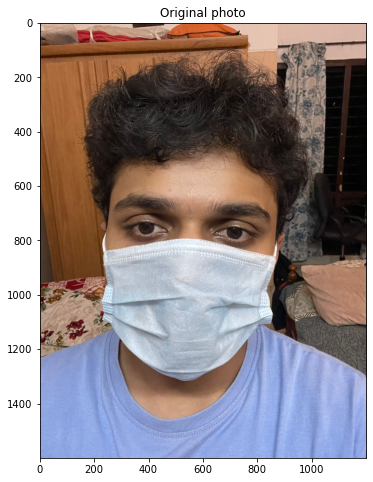

(797, 665, 3)
Total predicted classes are: 1
0


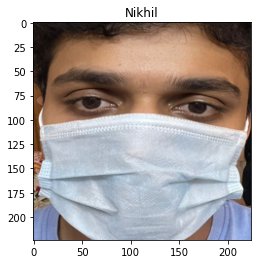

In [122]:
test_model_on_photo_all_faces_from_path("f11.jpeg")

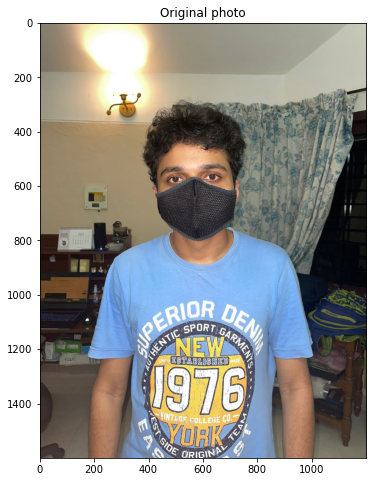

(340, 285, 3)
Total predicted classes are: 1
0


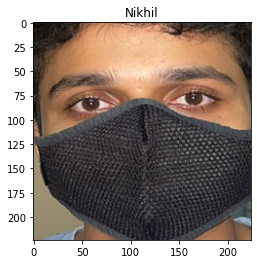

In [119]:
test_model_on_photo_all_faces_from_path("f10.jpeg")

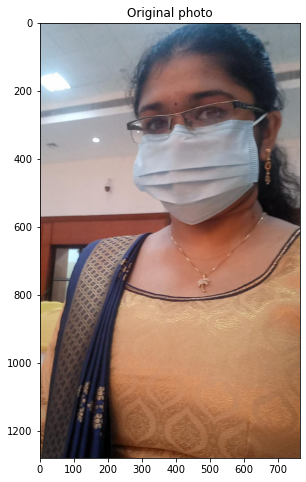

Total predicted classes are: 1
1


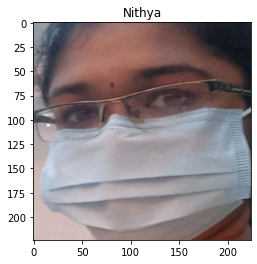

In [120]:
test_model_on_photo_from_path("f15.jpeg")

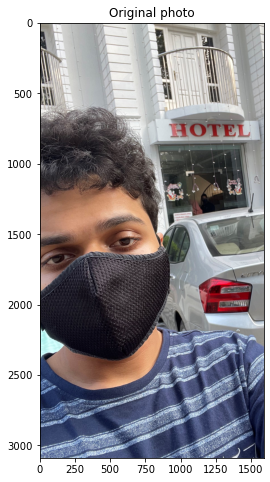

Total predicted classes are: 1
0


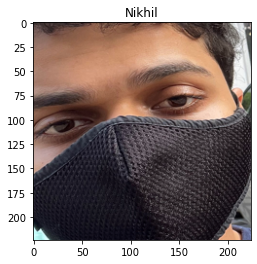

In [124]:
test_model_on_photo_from_path("f16.jpg")

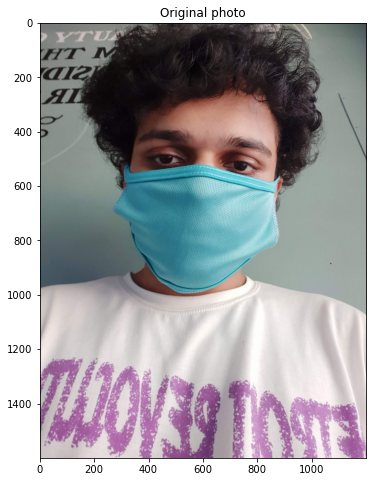

Total predicted classes are: 1
0


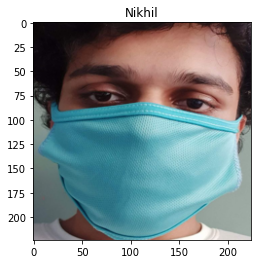

In [126]:
test_model_on_photo_from_path("f16.jpeg")

In [133]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

ModuleNotFoundError: No module named 'termios'

In [132]:
pip install google.colab


Note: you may need to restart the kernel to use updated packages.


In [135]:
pip install termios v0.1.8


Note: you may need to restart the kernel to use updated packages.


ERROR: Could not find a version that satisfies the requirement termios (from versions: none)
ERROR: No matching distribution found for termios


In [134]:
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))
  
  # Show the image which was just taken.
  #display(Image(filename))
  test_model_on_photo_from_path(filename, True)
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

name 'take_photo' is not defined
